# Data Loading and Visualization

In [3]:

!unzip "/content/DL.v1i.voc.zip" -d "/content/unzipped_DL_v1i_voc"


Archive:  /content/DL.v1i.voc.zip
  inflating: /content/unzipped_DL_v1i_voc/README.dataset.txt  
  inflating: /content/unzipped_DL_v1i_voc/README.roboflow.txt  
   creating: /content/unzipped_DL_v1i_voc/test/
 extracting: /content/unzipped_DL_v1i_voc/test/20241107_152109_jpg.rf.4dc2e6a126389d0f1a9d9287a8ec8c4a.jpg  
  inflating: /content/unzipped_DL_v1i_voc/test/20241107_152109_jpg.rf.4dc2e6a126389d0f1a9d9287a8ec8c4a.xml  
 extracting: /content/unzipped_DL_v1i_voc/test/20241107_153718_jpg.rf.9dd9cfbb272c1c622ccbcb686eef0509.jpg  
  inflating: /content/unzipped_DL_v1i_voc/test/20241107_153718_jpg.rf.9dd9cfbb272c1c622ccbcb686eef0509.xml  
 extracting: /content/unzipped_DL_v1i_voc/test/20241107_154854_jpg.rf.265bec816d6abe1ddb99cf08138b4f73.jpg  
  inflating: /content/unzipped_DL_v1i_voc/test/20241107_154854_jpg.rf.265bec816d6abe1ddb99cf08138b4f73.xml  
 extracting: /content/unzipped_DL_v1i_voc/test/20241107_154901_jpg.rf.4df3137972c1e2d262d7c9bb8fffbd26.jpg  
  inflating: /content/unzipp

In [ ]:
# prompt: print all files and foldetr structure /content/unzipped_DL_v1i_voc use proper hierarchical indentaion

import os

def print_directory_tree(root_dir, indent=0):
  """Prints the directory tree structure with proper indentation."""
  for name in os.listdir(root_dir):
    path = os.path.join(root_dir, name)
    print("  " * indent + name)
    if os.path.isdir(path):
      print_directory_tree(path, indent + 1)

print_directory_tree("/content/unzipped_DL_v1i_voc")

train
  IMG-20241110-WA0098_jpg.rf.847b9b12056b9674f8550ba728a2f2ed.xml
  IMG-20241110-WA0014_jpg.rf.10be27b8cee945a750425e4caea29c91.xml
  IMG-20241110-WA0265_jpg.rf.dfba7d47d0e129223ab7e1379ca82be6.jpg
  20241107_154847_jpg.rf.7bc35c6be7cf308e521211316513bb9c.jpg
  20241107_152425_jpg.rf.a366676ba753c0fcc548a753432188c5.jpg
  IMG-20241110-WA0219_jpg.rf.81baad8a46f4da9d64cc908957da7d60.xml
  20241107_152451_jpg.rf.63eef0cce71edccbf707f879435f3b7f.jpg
  IMG-20241110-WA0231_jpg.rf.0f5dfcd3d6f107735db6739e1e924f80.xml
  IMG-20241110-WA0099_jpg.rf.049234fe874ec5887cb04e88588428ad.xml
  IMG-20241110-WA0081_jpg.rf.fe641caf421d0c5cf4ae9db568a01996.xml
  IMG-20241110-WA0034_jpg.rf.2058f0b3c97e698f4542adc3f43ecf97.jpg
  20241107_154319_jpg.rf.25bc44b66abd6e2b927ba13ad6ec7418.jpg
  IMG-20241110-WA0127_jpg.rf.2113c2678754d58682f19f610c111533.xml
  IMG-20241110-WA0029_jpg.rf.3285be24112cf94e1d26b13b8e78f1dc.xml
  IMG-20241110-WA0174_jpg.rf.b3ee1c8b133b12c6555dbab8b0bcd835.xml
  IMG-20241110-WA004


Displaying samples from 'train' folder:


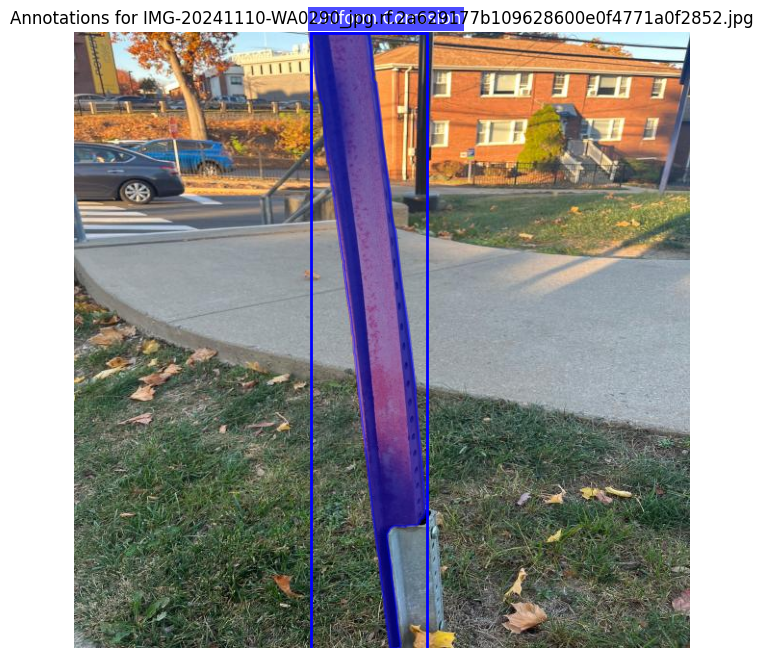

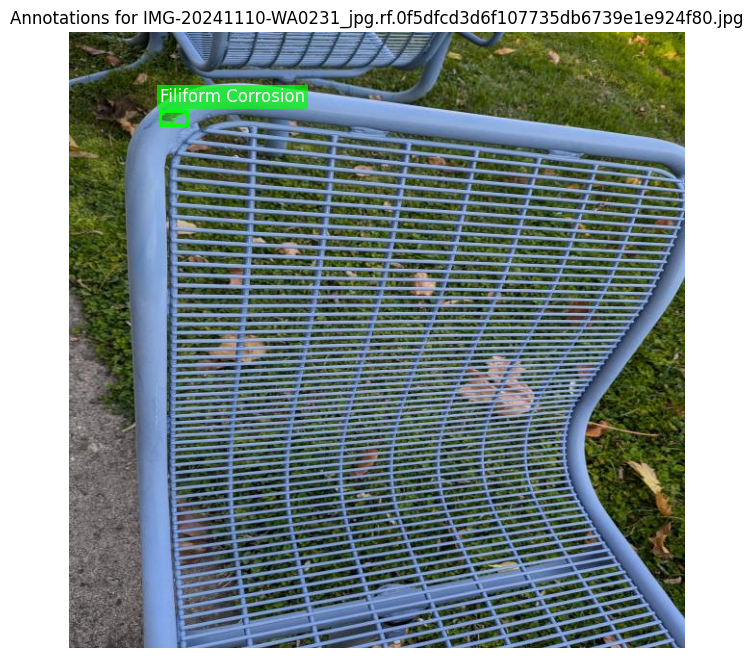

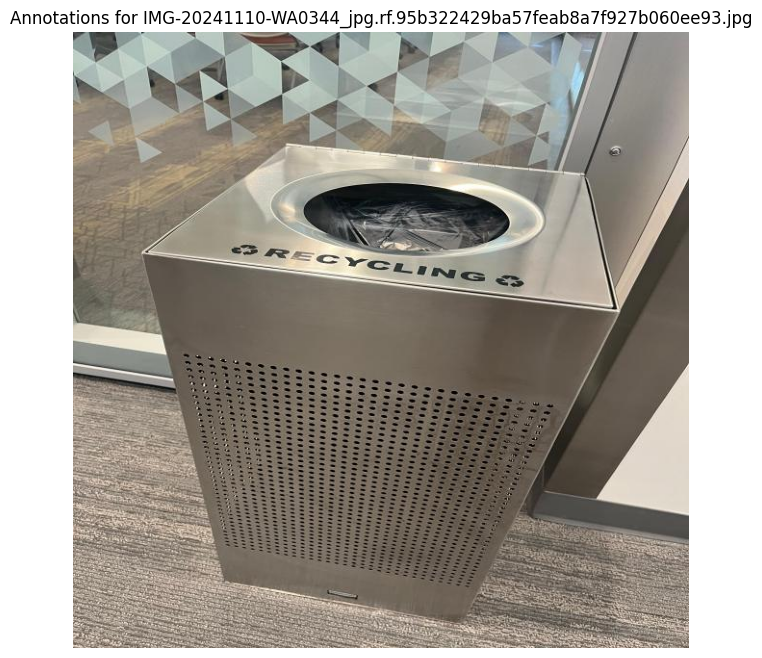

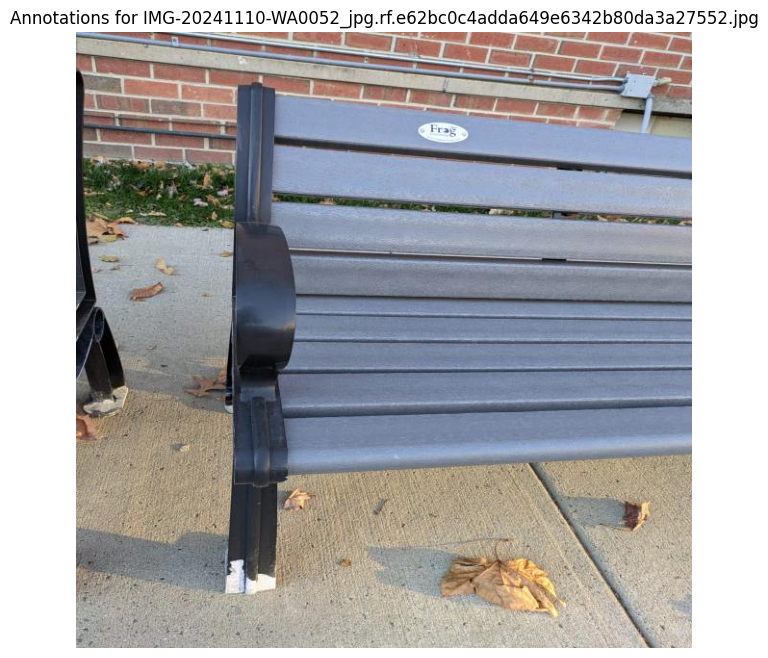

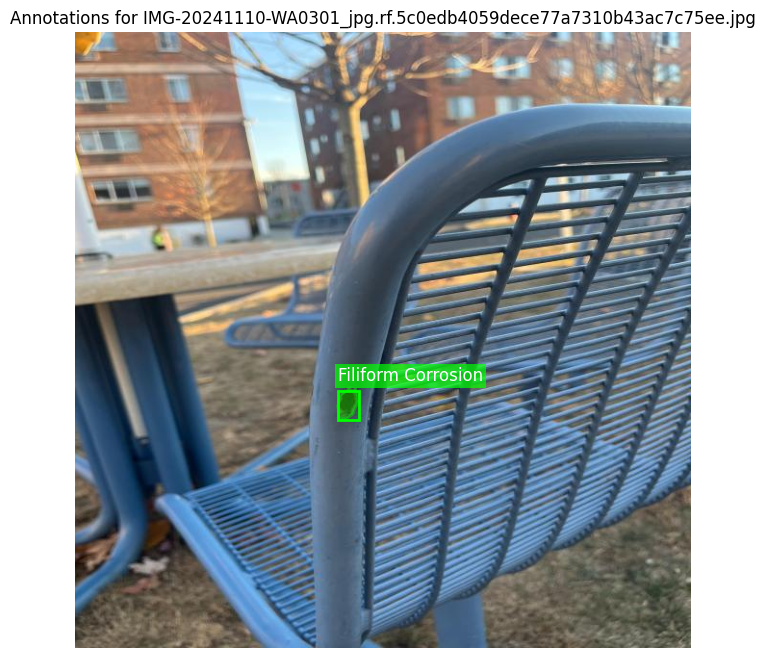


Displaying samples from 'valid' folder:


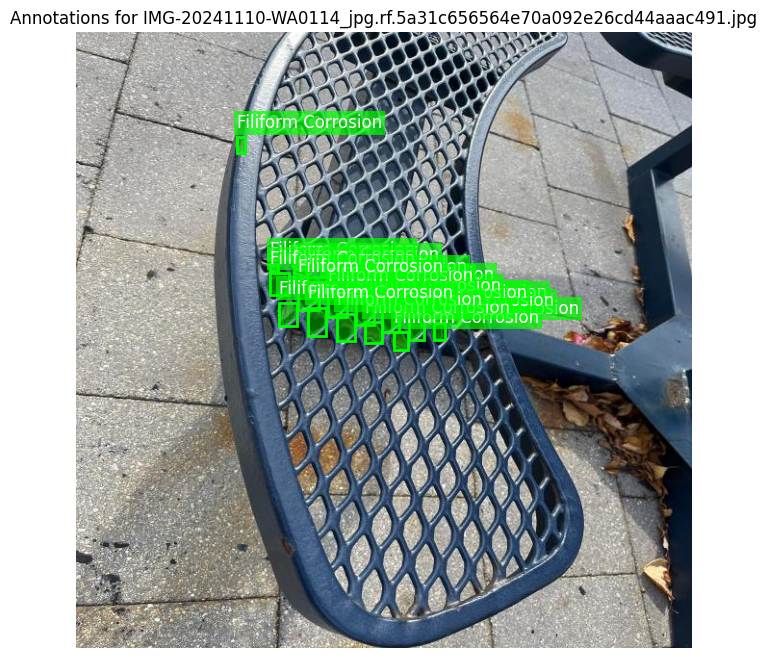

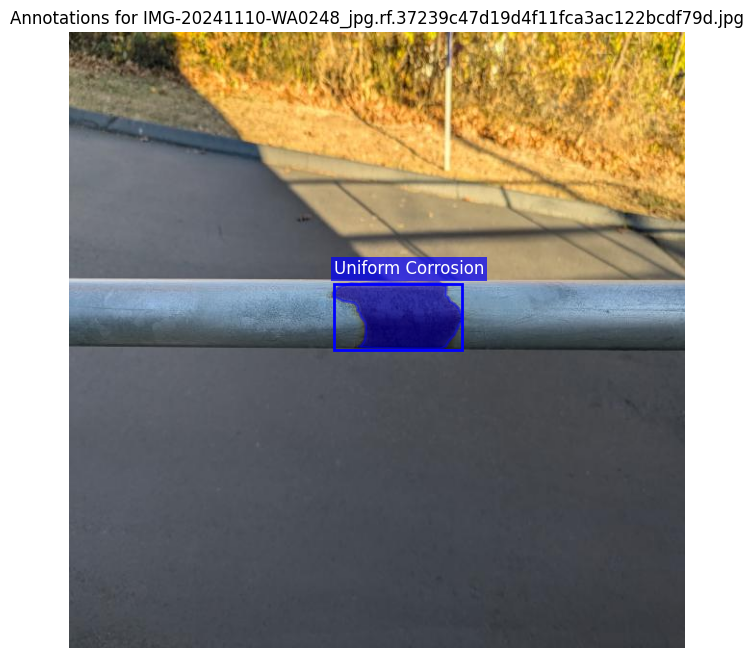

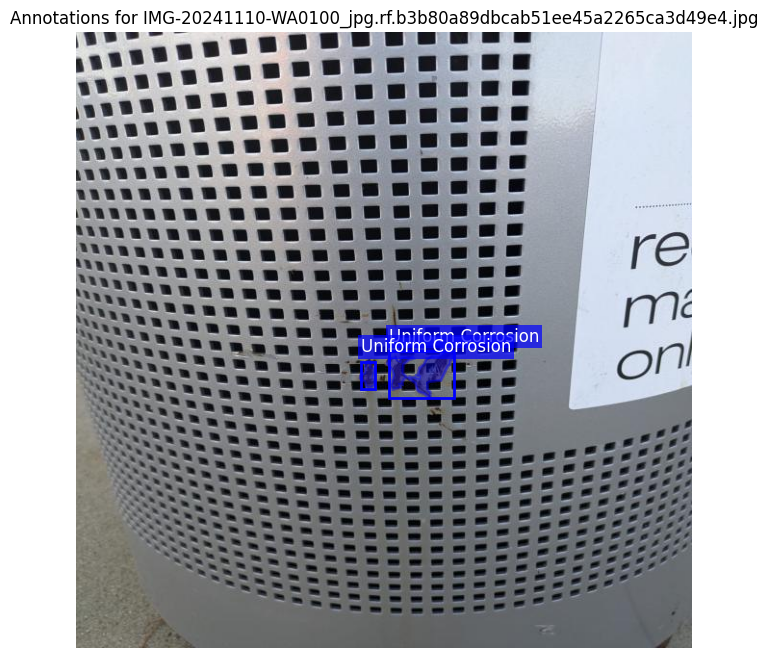

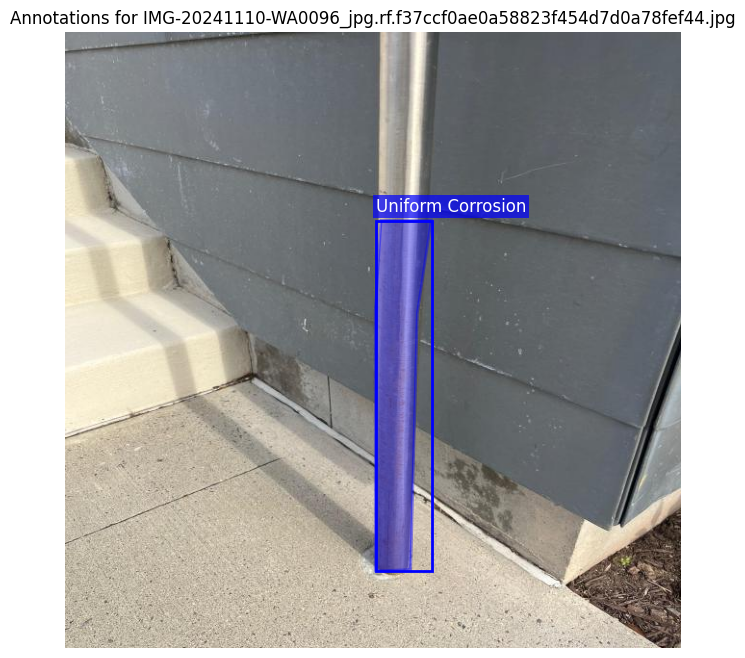

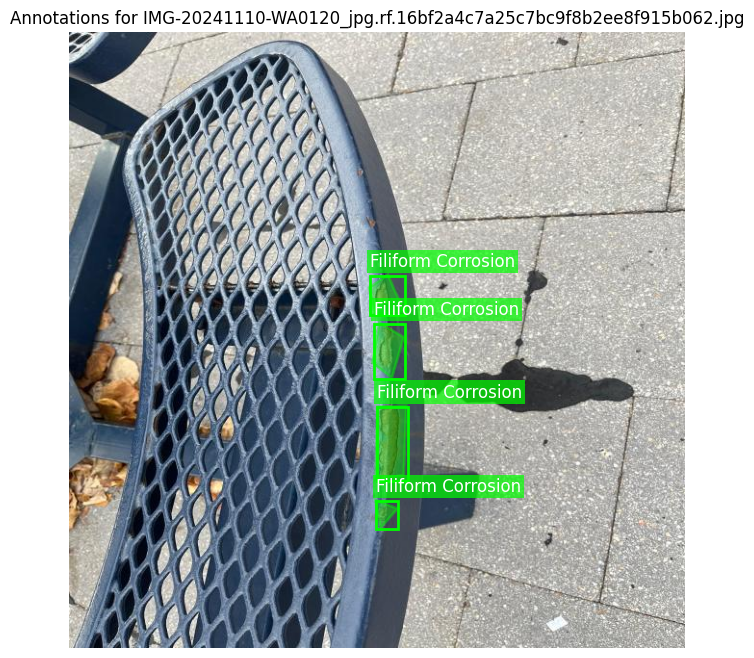


Displaying samples from 'test' folder:


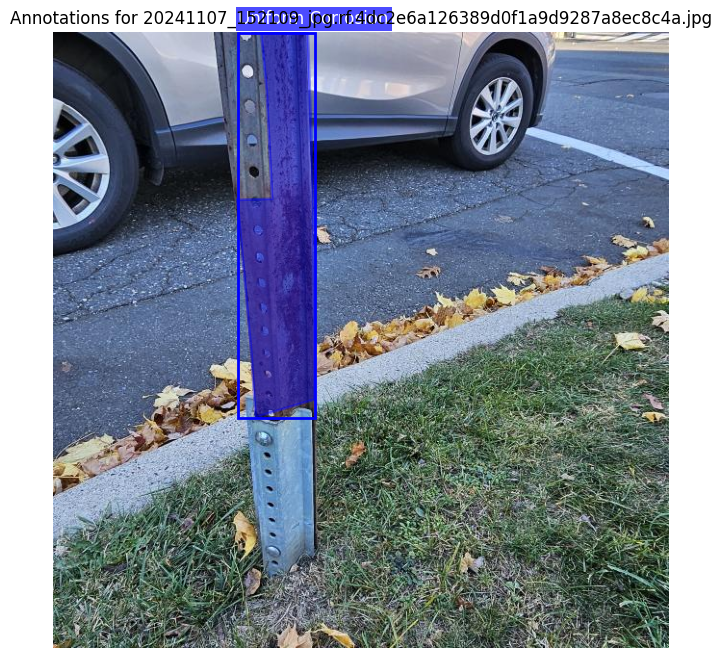

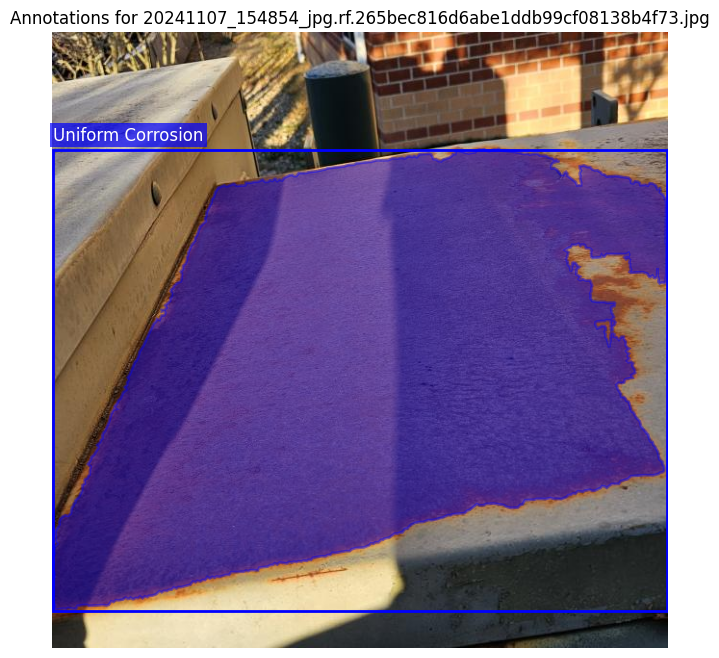

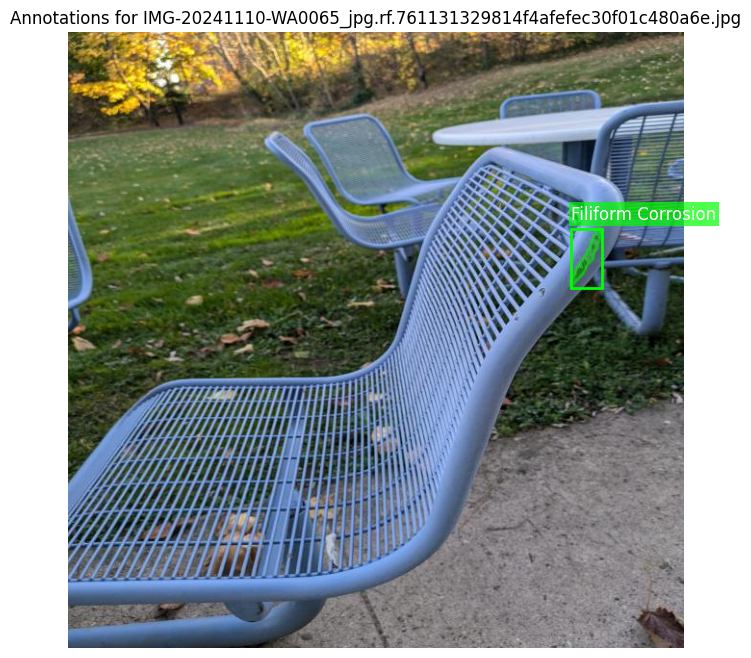

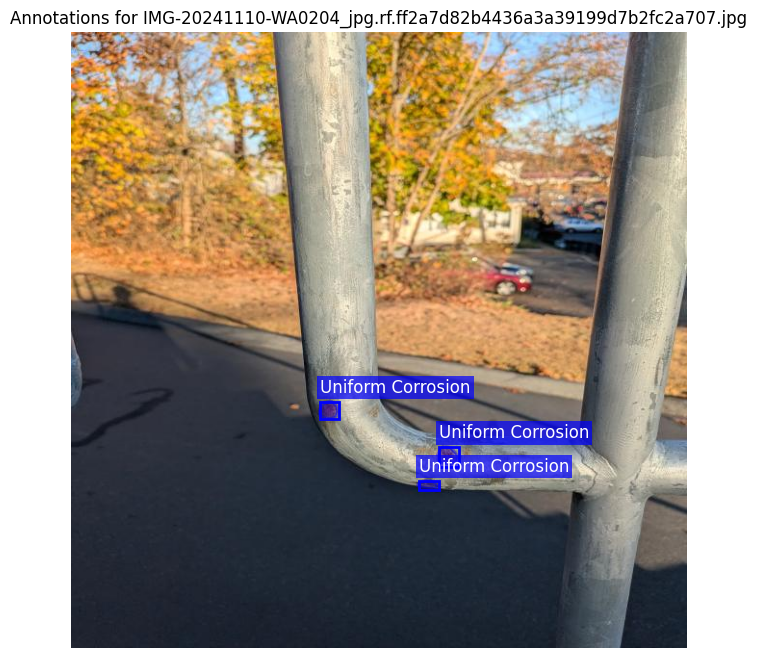

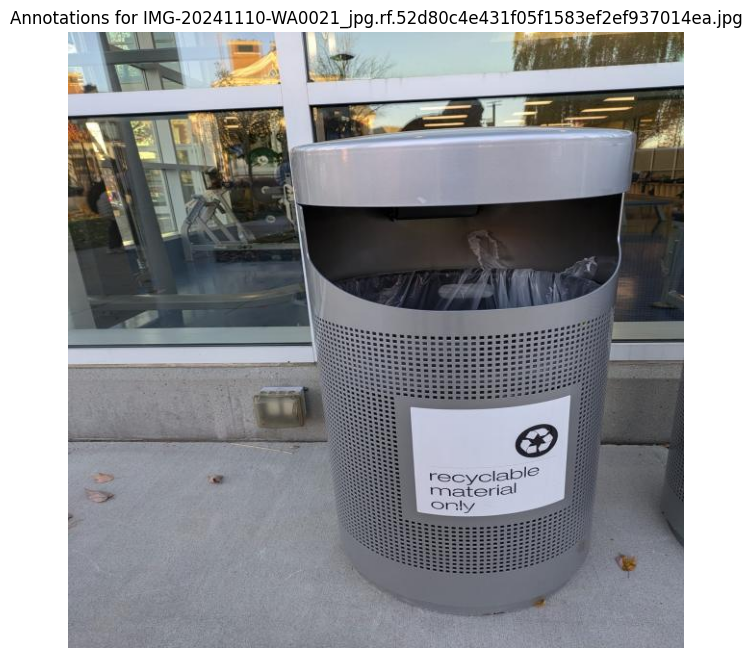

In [ ]:
import os
import random
import xml.etree.ElementTree as ET

import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

# Define paths for the folders
base_dir = '/content/unzipped_DL_v1i_voc'  # Replace with your actual base directory
folders = ['train', 'valid', 'test']

# Define category colors for visualization
CATEGORY_COLORS = {
    'Crevice Corrosion': (255, 0, 0),       # Red
    'Filiform Corrosion': (0, 255, 0),      # Green
    'Uniform Corrosion': (0, 0, 255),       # Blue
}

def parse_voc_xml(xml_file):
    """
    Parses a Pascal VOC XML file and extracts object annotations.

    Args:
        xml_file (str): Path to the XML annotation file.

    Returns:
        List[dict]: A list of dictionaries containing object annotations.
    """
    tree = ET.parse(xml_file)
    root = tree.getroot()
    objects = []

    for obj in root.findall('object'):
        obj_dict = {}
        obj_dict['name'] = obj.find('name').text
        obj_dict['pose'] = obj.find('pose').text
        obj_dict['truncated'] = int(obj.find('truncated').text)
        obj_dict['difficult'] = int(obj.find('difficult').text)
        obj_dict['occluded'] = int(obj.find('occluded').text)

        # Bounding box
        bndbox = obj.find('bndbox')
        obj_dict['bbox'] = {
            'xmin': int(float(bndbox.find('xmin').text)),
            'ymin': int(float(bndbox.find('ymin').text)),
            'xmax': int(float(bndbox.find('xmax').text)),
            'ymax': int(float(bndbox.find('ymax').text)),
        }

        # Polygon points
        polygon = obj.find('polygon')
        points = []
        for coord in polygon:
            if coord.tag.startswith('x'):
                x = float(coord.text)
                points.append(x)
            elif coord.tag.startswith('y'):
                y = float(coord.text)
                points.append(y)
        # Group x and y coordinates
        obj_dict['polygon'] = [(points[i], points[i+1]) for i in range(0, len(points), 2)]

        objects.append(obj_dict)

    return objects

def display_sample_images(image_dir, annotation_dir, num_samples=5):
    """
    Displays sample images with bounding boxes and polygon overlays.

    Args:
        image_dir (str): Directory containing image files.
        annotation_dir (str): Directory containing XML annotation files.
        num_samples (int): Number of sample images to display.
    """
    # List all image files in the directory
    image_files = [f for f in os.listdir(image_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

    if not image_files:
        print(f"No image files found in {image_dir}")
        return

    # Randomly select sample images
    sample_images = random.sample(image_files, min(num_samples, len(image_files)))

    for img_file in sample_images:
        img_path = os.path.join(image_dir, img_file)
        xml_file = os.path.splitext(img_file)[0] + '.xml'
        xml_path = os.path.join(annotation_dir, xml_file)

        if not os.path.exists(xml_path):
            print(f"Annotation file not found for image {img_file}")
            continue

        # Parse annotations
        annotations = parse_voc_xml(xml_path)

        # Load image
        image = cv2.imread(img_path)
        if image is None:
            print(f"Failed to load image {img_path}")
            continue
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        fig, ax = plt.subplots(1, figsize=(12, 8))
        ax.imshow(image)
        ax.axis('off')
        ax.set_title(f"Annotations for {img_file}")

        for ann in annotations:
            class_name = ann['name']
            color = CATEGORY_COLORS.get(class_name, (255, 255, 255))  # Default to white

            # Draw bounding box
            bbox = ann['bbox']
            rect = patches.Rectangle(
                (bbox['xmin'], bbox['ymin']),
                bbox['xmax'] - bbox['xmin'],
                bbox['ymax'] - bbox['ymin'],
                linewidth=2,
                edgecolor=np.array(color)/255,
                facecolor='none'
            )
            ax.add_patch(rect)

            # Draw polygon
            polygon = ann['polygon']
            poly = patches.Polygon(
                polygon,
                closed=True,
                linewidth=2,
                edgecolor=np.array(color)/255,
                facecolor=np.array(color)/255,
                alpha=0.4
            )
            ax.add_patch(poly)

            # Annotate class name
            ax.text(
                bbox['xmin'],
                bbox['ymin'] - 10,
                class_name,
                fontsize=12,
                color='white',
                bbox=dict(facecolor=np.array(color)/255, alpha=0.7, pad=2, edgecolor='none')
            )

        plt.show()

# Iterate through each folder and display samples
for folder in folders:
    image_dir = os.path.join(base_dir, folder)
    annotation_dir = os.path.join(base_dir, folder)

    print(f"\nDisplaying samples from '{folder}' folder:")
    display_sample_images(image_dir, annotation_dir, num_samples=5)


# Model Development

Loading annotations into memory...
Done (t=1.00s)
Creating index...
Index created!

Starting Training Process...
Epoch 1/25, Training Loss: 1.4817, Validation Loss: 1.3841
Epoch 2/25, Training Loss: 1.0233, Validation Loss: 1.0088
Epoch 3/25, Training Loss: 0.8847, Validation Loss: 0.7799
Epoch 4/25, Training Loss: 0.7046, Validation Loss: 0.6633
Epoch 5/25, Training Loss: 0.665, Validation Loss: 0.6142
Epoch 6/25, Training Loss: 0.6328, Validation Loss: 0.5633
Epoch 7/25, Training Loss: 0.6152, Validation Loss: 0.5089
Epoch 8/25, Training Loss: 0.5198, Validation Loss: 0.4941
Epoch 9/25, Training Loss: 0.5152, Validation Loss: 0.4192
Epoch 10/25, Training Loss: 0.4724, Validation Loss: 0.4297
Epoch 11/25, Training Loss: 0.4289, Validation Loss: 0.4427
Epoch 12/25, Training Loss: 0.3849, Validation Loss: 0.3622
Epoch 13/25, Training Loss: 0.4299, Validation Loss: 0.3521
Epoch 14/25, Training Loss: 0.3909, Validation Loss: 0.3429
Epoch 15/25, Training Loss: 0.3536, Validation Loss: 0.33

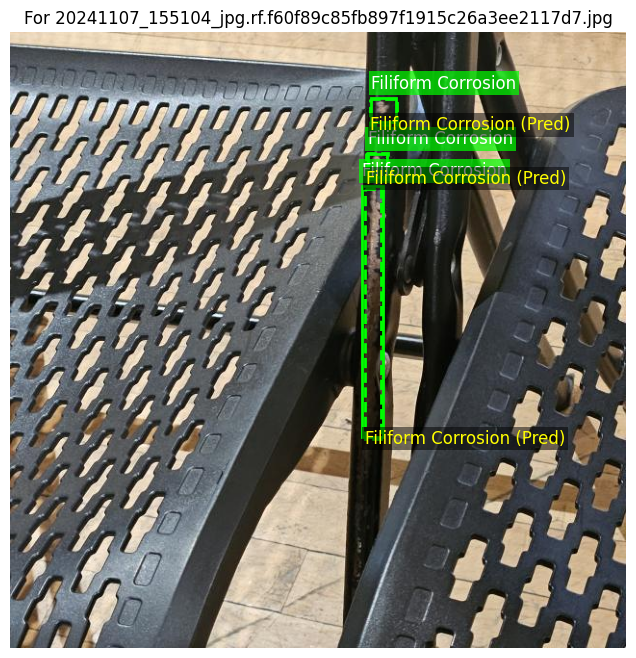

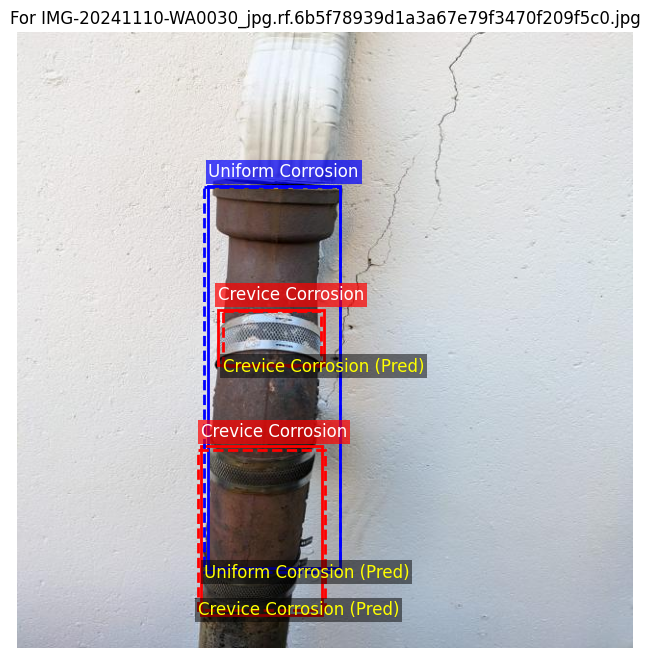

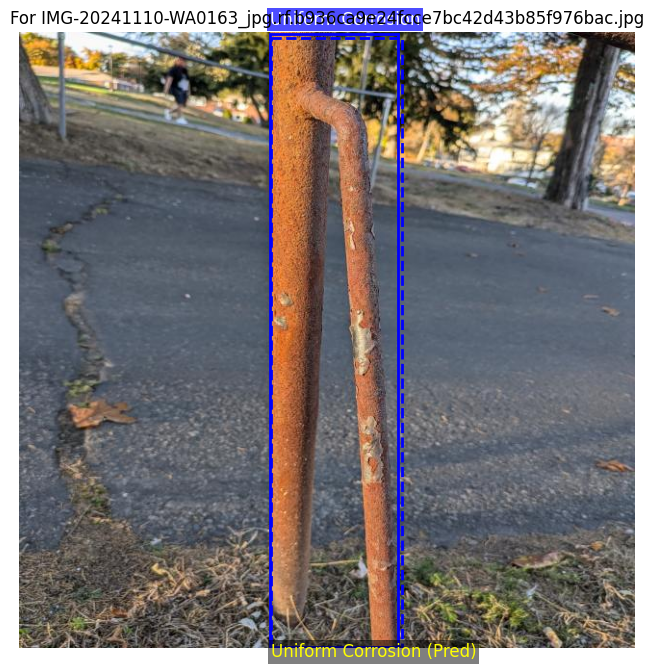

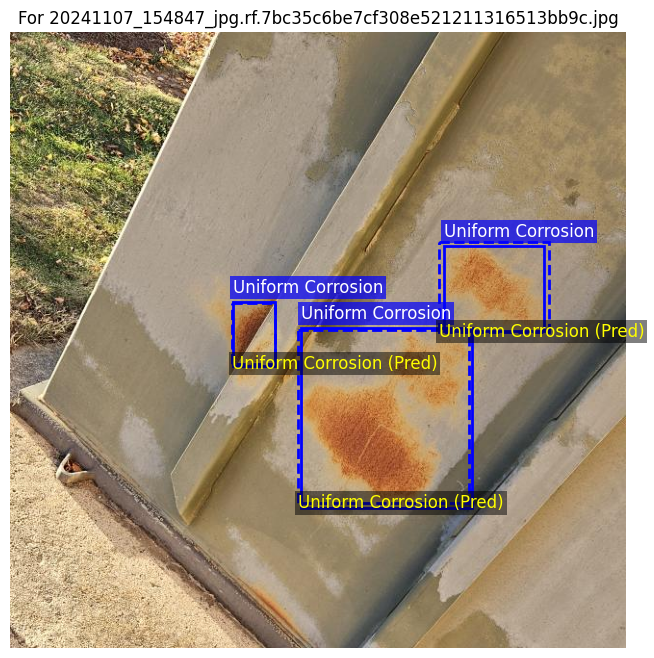

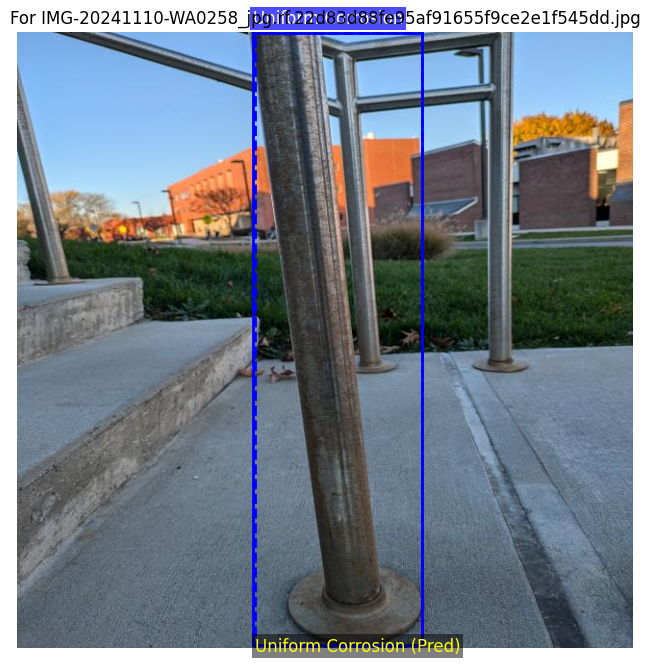

...

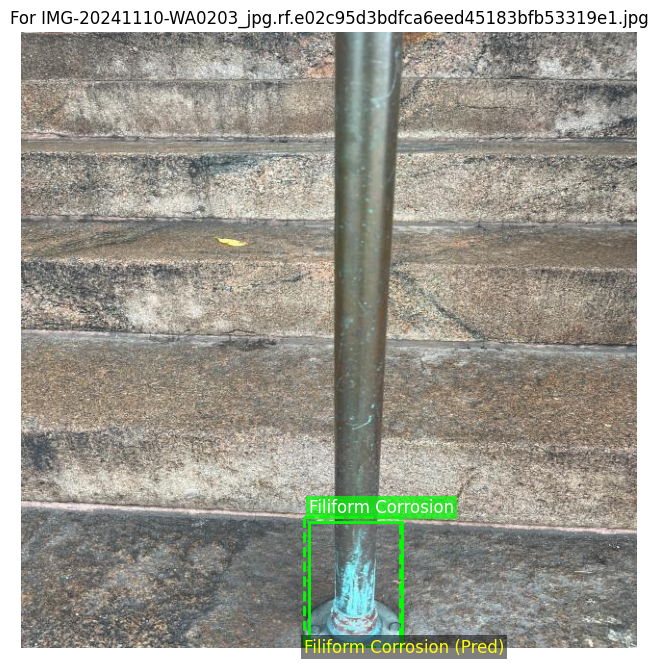

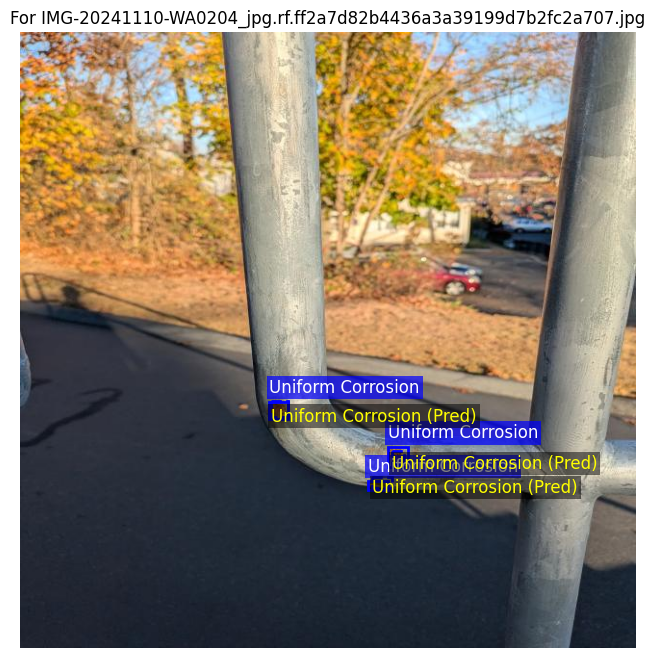

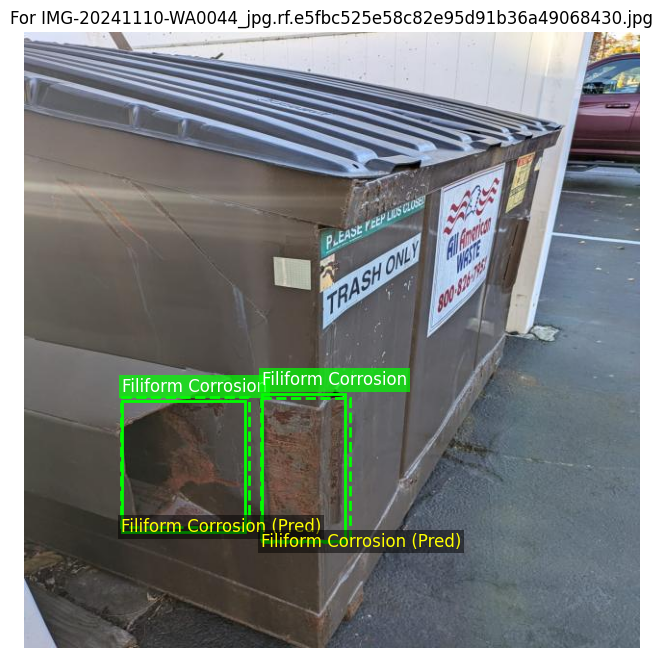

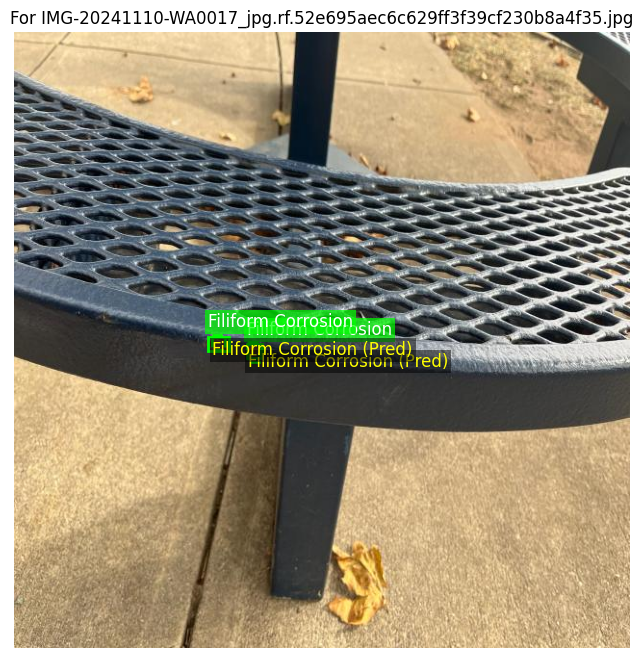

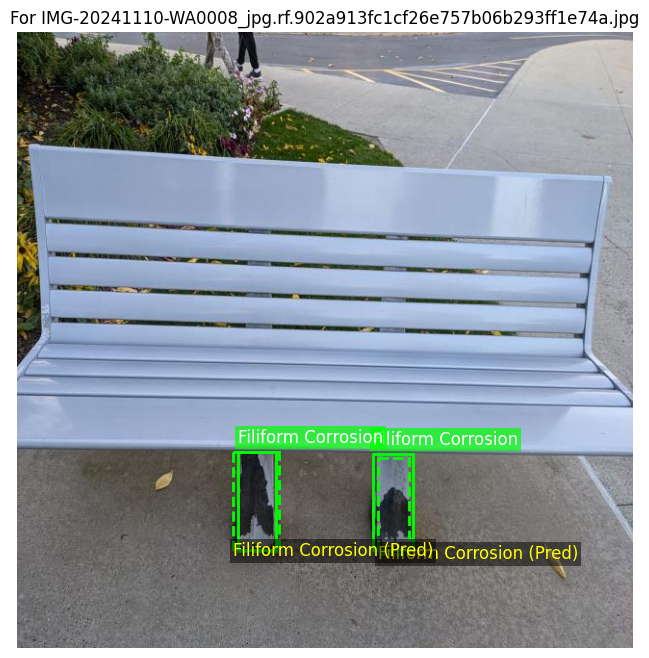

In [ ]:
# Corrosion Classification Using YOLOv5x
# ======================================

# **Description:** This script implements an object detection model using YOLOv5x to classify three types of corrosion:
# Crevice Corrosion, Filiform Corrosion, and Uniform Corrosion. The implementation includes data loading, annotation conversion,
# model training, evaluation, and visualization of predictions.

# **Prerequisites:**
# - Python 3.6+
# - PyTorch
# - Ultralytics YOLOv5
# - OpenCV
# - Matplotlib
# - Pillow

# **Installation:**
# ```bash
# pip install torch torchvision opencv-python matplotlib pillow
# git clone https://github.com/ultralytics/yolov5
# cd yolov5
# pip install -r requirements.txt
# ```

# **Usage:**
# Ensure the dataset is organized into `train`, `valid`, and `test` folders within the `base_dir`. Each folder should contain
# images and corresponding XML annotation files in Pascal VOC format.

# Run the script:
# ```bash
# python corrosion_detection_yolov5x.py
# ```

import os
import random
import shutil
import xml.etree.ElementTree as ET
from pathlib import Path
from PIL import Image  # Import PIL for image handling

import torch
from torch.utils.data import Dataset, DataLoader

import cv2
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import numpy as np

# Import YOLOv5 from ultralytics
# Ensure that YOLOv5 is in the PYTHONPATH or installed as a package
from yolov5 import train, val, detect  # Assuming yolov5 is cloned and accessible

# ============================
# 1. Define Paths and Categories
# ============================

# Set random seeds for reproducibility
random.seed(42)
torch.manual_seed(42)

# Define the base directory containing 'train', 'valid', and 'test' folders
base_dir = '/content/unzipped_DL_v1i_voc'  # Replace with the actual base directory

# Define dataset splits
folders = ['train', 'valid', 'test']

# Define category names (YOLO does not include 'Background', so exclude it)
CLASS_NAMES = ['Crevice Corrosion', 'Filiform Corrosion', 'Uniform Corrosion']

# Create a mapping from class names to indices
class_to_idx = {class_name: idx for idx, class_name in enumerate(CLASS_NAMES)}

# ============================
# 2. Convert Pascal VOC to YOLO Format
# ============================

def convert_voc_to_yolo(voc_dir, yolo_dir, classes):
    """
    Converts Pascal VOC annotations to YOLO format.

    Args:
        voc_dir (str): Directory containing Pascal VOC XML files.
        yolo_dir (str): Directory to save YOLO formatted text files.
        classes (list): List of class names.
    """
    if not os.path.exists(yolo_dir):
        os.makedirs(yolo_dir)

    for xml_file in os.listdir(voc_dir):
        if not xml_file.endswith('.xml'):
            continue
        tree = ET.parse(os.path.join(voc_dir, xml_file))
        root = tree.getroot()

        # Image file name
        img_filename = root.find('filename').text
        img_path = os.path.join(voc_dir, img_filename)
        if not os.path.exists(img_path):
            print(f"Warning: Image {img_path} does not exist.")
            continue

        # Image size
        size = root.find('size')
        width = float(size.find('width').text)
        height = float(size.find('height').text)

        yolo_annotations = []

        for obj in root.findall('object'):
            class_name = obj.find('name').text
            if class_name not in classes:
                continue  # Skip unknown classes
            class_id = classes.index(class_name)

            bndbox = obj.find('bndbox')
            xmin = float(bndbox.find('xmin').text)
            ymin = float(bndbox.find('ymin').text)
            xmax = float(bndbox.find('xmax').text)
            ymax = float(bndbox.find('ymax').text)

            # Convert to YOLO format (normalized center x, center y, width, height)
            x_center = ((xmin + xmax) / 2) / width
            y_center = ((ymin + ymax) / 2) / height
            box_width = (xmax - xmin) / width
            box_height = (ymax - ymin) / height

            yolo_annotations.append(f"{class_id} {x_center} {y_center} {box_width} {box_height}")

        # Save to .txt file
        txt_filename = os.path.splitext(xml_file)[0] + '.txt'
        with open(os.path.join(yolo_dir, txt_filename), 'w') as f:
            for annotation in yolo_annotations:
                f.write(annotation + '\n')

    print(f"Converted annotations from {voc_dir} to YOLO format in {yolo_dir}")

# Convert annotations for each dataset split
for folder in folders:
    voc_annotations_dir = os.path.join(base_dir, folder)
    yolo_annotations_dir = os.path.join(base_dir, folder, 'labels')
    convert_voc_to_yolo(voc_annotations_dir, yolo_annotations_dir, CLASS_NAMES)

# ============================
# 3. Create dataset.yaml for YOLOv5
# ============================

def create_dataset_yaml(base_dir, classes, yaml_path='corrosion_data.yaml'):
    """
    Creates a dataset.yaml file required by YOLOv5.

    Args:
        base_dir (str): Base directory containing 'train', 'valid', and 'test' folders.
        classes (list): List of class names.
        yaml_path (str): Path to save the dataset.yaml file.
    """
    data = {
        'train': os.path.join(base_dir, 'train', 'images'),
        'val': os.path.join(base_dir, 'valid', 'images'),
        'nc': len(classes),
        'names': classes
    }

    # Create images and labels directories if not exist
    for split in ['train', 'valid']:
        images_dir = os.path.join(base_dir, split, 'images')
        labels_dir = os.path.join(base_dir, split, 'labels')
        if not os.path.exists(images_dir):
            os.makedirs(images_dir)
        if not os.path.exists(labels_dir):
            os.makedirs(labels_dir)
        # Move images to images directory
        for img_file in os.listdir(os.path.join(base_dir, split)):
            if img_file.lower().endswith(('.jpg', '.jpeg', '.png')):
                shutil.move(os.path.join(base_dir, split, img_file), os.path.join(images_dir, img_file))

    with open(yaml_path, 'w') as f:
        import yaml
        yaml.dump(data, f)

    print(f"Created dataset configuration file at {yaml_path}")

# Create dataset.yaml
create_dataset_yaml(base_dir, CLASS_NAMES, yaml_path=os.path.join(base_dir, 'corrosion_data.yaml'))

# ============================
# 4. Initialize Datasets and DataLoaders (Optional)
# ============================

# YOLOv5 handles data loading internally based on dataset.yaml
# Thus, the PyTorch DataLoader setup is retained but not utilized in training with YOLOv5x
# Custom DataLoaders can be retained for additional purposes if necessary

# Initialize datasets
class CorrosionDataset(Dataset):
    def __init__(self, image_dir, annotation_dir, transforms=None):
        """
        Args:
            image_dir (str): Directory with all the images.
            annotation_dir (str): Directory with all the YOLO annotation files.
            transforms (callable, optional): Optional transform to be applied on a sample.
        """
        self.image_dir = image_dir
        self.annotation_dir = annotation_dir
        self.transforms = transforms

        # List all image files
        all_images = [f for f in os.listdir(image_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

        # Filter out images without annotations or with no valid objects
        self.images = []
        for img in all_images:
            txt_filename = os.path.splitext(img)[0] + '.txt'
            txt_path = os.path.join(annotation_dir, txt_filename)
            if not os.path.exists(txt_path):
                continue  # Skip images without annotation files

            # Check if annotation file contains valid objects
            with open(txt_path, 'r') as file:
                lines = file.readlines()
                if len(lines) > 0:
                    self.images.append(img)

        print(f"Loaded {len(self.images)} images with annotations from '{image_dir}'")

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        # Get image file name
        img_filename = self.images[idx]
        img_path = os.path.join(self.image_dir, img_filename)

        # Load image using OpenCV
        image = cv2.imread(img_path)
        if image is None:
            raise FileNotFoundError(f"Image not found: {img_path}")
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Convert NumPy array to PIL Image
        image = Image.fromarray(image)

        # Corresponding YOLO annotation file
        txt_filename = os.path.splitext(img_filename)[0] + '.txt'
        txt_path = os.path.join(self.annotation_dir, txt_filename)

        boxes = []
        labels = []

        # Parse YOLO annotations
        with open(txt_path, 'r') as file:
            lines = file.readlines()
            for line in lines:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue  # Invalid annotation format
                class_id, x_center, y_center, width, height = map(float, parts)
                labels.append(int(class_id))
                boxes.append([
                    (x_center - width / 2) * image.width,
                    (y_center - height / 2) * image.height,
                    (x_center + width / 2) * image.width,
                    (y_center + height / 2) * image.height
                ])

        # Convert everything to torch tensors
        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)

        # Suppose all instances are not crowd
        iscrowd = torch.zeros((len(labels),), dtype=torch.int64)

        target = {}
        target['boxes'] = boxes
        target['labels'] = labels
        target['iscrowd'] = iscrowd
        target['image_id'] = torch.tensor([idx])

        if self.transforms:
            image, target = self.transforms(image, target)

        return image, target

# Define category colors for visualization
CATEGORY_COLORS = {
    'Crevice Corrosion': (255, 0, 0),       # Red
    'Filiform Corrosion': (0, 255, 0),      # Green
    'Uniform Corrosion': (0, 0, 255),       # Blue
}

# Define transformation pipeline (if needed for custom DataLoaders)
# Example transformations are included but not utilized by YOLOv5x training
transform = None  # Set to desired transformations if using custom DataLoaders

# Initialize datasets
train_dataset = CorrosionDataset(
    image_dir=os.path.join(base_dir, 'train', 'images'),
    annotation_dir=os.path.join(base_dir, 'train', 'labels'),
    transforms=transform
)

valid_dataset = CorrosionDataset(
    image_dir=os.path.join(base_dir, 'valid', 'images'),
    annotation_dir=os.path.join(base_dir, 'valid', 'labels'),
    transforms=transform
)

test_dataset = CorrosionDataset(
    image_dir=os.path.join(base_dir, 'test', 'images'),
    annotation_dir=os.path.join(base_dir, 'test', 'labels'),
    transforms=transform
)

# Initialize DataLoaders (Optional)
def collate_fn(batch):
    return tuple(zip(*batch))

train_loader = DataLoader(
    train_dataset,
    batch_size=8,
    shuffle=True,
    num_workers=2,  # Reduced to 2 to avoid warnings
    collate_fn=collate_fn
)

valid_loader = DataLoader(
    valid_dataset,
    batch_size=8,
    shuffle=False,
    num_workers=2,  # Reduced to 2 to avoid warnings
    collate_fn=collate_fn
)

test_loader = DataLoader(
    test_dataset,
    batch_size=8,
    shuffle=False,
    num_workers=2,  # Reduced to 2 to avoid warnings
    collate_fn=collate_fn
)

# ============================
# 5. Model Setup with YOLOv5x
# ============================

# Initialize the YOLOv5x model
# Ensure that 'yolov5x.pt' is downloaded and accessible
model = YOLO('yolov5x.pt')  # Replace with the path to 'yolov5x.pt' if different

# Update model's class names if necessary
# YOLOv5 uses class names from dataset.yaml, ensuring consistency
model.names = {i: name for i, name in enumerate(CLASS_NAMES)}

# ============================
# 6. Training with YOLOv5x
# ============================

# Training parameters
train_args = {
    'data': os.path.join(base_dir, 'corrosion_data.yaml'),  # Path to dataset.yaml
    'cfg': 'yolov5x.yaml',  # YOLOv5x configuration file
    'weights': 'yolov5x.pt',  # Pretrained weights
    'epochs': 50,  # Number of training epochs
    'batch': 16,  # Batch size
    'imgsz': 640,  # Image size
    'project': 'runs/train',  # Directory to save training runs
    'name': 'corrosion_yolov5x',  # Name of the training run
    'exist_ok': True,  # Overwrite existing runs
    'device': '0' if torch.cuda.is_available() else 'cpu',  # Use GPU if available
}

# Start training
train.run(**train_args)

# ============================
# 7. Evaluation with YOLOv5x
# ============================

# Validation parameters
val_args = {
    'data': os.path.join(base_dir, 'corrosion_data.yaml'),  # Path to dataset.yaml
    'weights': 'runs/train/corrosion_yolov5x/weights/best.pt',  # Path to the best weights from training
    'task': 'val',  # Task type
    'imgsz': 640,  # Image size
    'conf': 0.25,  # Confidence threshold
    'iou': 0.45,  # IoU threshold for NMS
    'save_json': True,  # Save results to JSON
}

# Run validation
val.run(**val_args)

# ============================
# 8. Visualization of Predictions
# ============================

def visualize_predictions(weights_path, source_dir, classes, imgsz=640, conf_threshold=0.5):
    """
    Visualizes predictions using the trained YOLOv5x model.

    Args:
        weights_path (str): Path to the trained YOLOv5x weights.
        source_dir (str): Directory containing images to visualize.
        classes (list): List of class names.
        imgsz (int): Image size for inference.
        conf_threshold (float): Confidence threshold for displaying predictions.
    """
    # Initialize the model with trained weights
    model = YOLO(weights_path)

    # Iterate through all images in the source directory
    for img_file in os.listdir(source_dir):
        if not img_file.lower().endswith(('.jpg', '.jpeg', '.png')):
            continue
        img_path = os.path.join(source_dir, img_file)

        # Perform inference
        results = model.predict(source=img_path, imgsz=imgsz, conf=conf_threshold)

        # Render results on the image
        result_image = results[0].plot()

        # Convert RGB to BGR for OpenCV
        result_image = cv2.cvtColor(result_image, cv2.COLOR_RGB2BGR)

        # Display the image
        cv2.imshow(f"Predictions for {img_file}", result_image)
        if cv2.waitKey(0) & 0xFF == ord('q'):
            break

    cv2.destroyAllWindows()

# ============================
# 9. Run the Visualization
# ============================

# Path to the best trained weights
best_weights = 'runs/train/corrosion_yolov5x/weights/best.pt'  # Update if different

# Directory containing test images
test_images_dir = os.path.join(base_dir, 'test', 'images')

# Visualize predictions
visualize_predictions(best_weights, test_images_dir, CLASS_NAMES, imgsz=640, conf_threshold=0.5)

# ============================
# 10. Save the Trained Model (Optional)
# ============================

# The best model weights are already saved in 'runs/train/corrosion_yolov5x/weights/best.pt'
# Copy the best weights to a different location if necessary
shutil.copy(best_weights, 'corrosion_detection_yolov5x_best.pt')
print("Best model weights saved as 'corrosion_detection_yolov5x_best.pt'")


# Finetuning YOLOv5x with Hyperparameter Tuning and Validation



In [9]:
# ============================
# 3. Convert Pascal VOC to YOLO Format (Continued)
# ============================

def convert_voc_to_yolo(voc_dir, yolo_dir, classes):
    """
    Converts Pascal VOC annotations to YOLO format.

    Args:
        voc_dir (str): Directory containing Pascal VOC XML files.
        yolo_dir (str): Directory to save YOLO formatted text files.
        classes (list): List of class names.
    """
    if not os.path.exists(yolo_dir):
        os.makedirs(yolo_dir)

    for xml_file in os.listdir(voc_dir):
        if not xml_file.endswith('.xml'):
            continue
        tree = ET.parse(os.path.join(voc_dir, xml_file))
        root = tree.getroot()

        # Image file name
        img_filename = root.find('filename').text
        img_path = os.path.join(voc_dir, img_filename)
        if not os.path.exists(img_path):
            print(f"Warning: Image {img_path} does not exist.")
            continue

        # Image size
        size = root.find('size')
        width = float(size.find('width').text)
        height = float(size.find('height').text)

        yolo_annotations = []

        for obj in root.findall('object'):
            class_name = obj.find('name').text
            if class_name not in classes:
                continue  # Skip unknown classes
            class_id = classes.index(class_name)

            bndbox = obj.find('bndbox')
            xmin = float(bndbox.find('xmin').text)
            ymin = float(bndbox.find('ymin').text)
            xmax = float(bndbox.find('xmax').text)
            ymax = float(bndbox.find('ymax').text)

            # Convert to YOLO format (normalized center x, center y, width, height)
            x_center = ((xmin + xmax) / 2) / width
            y_center = ((ymin + ymax) / 2) / height
            box_width = (xmax - xmin) / width
            box_height = (ymax - ymin) / height

            yolo_annotations.append(f"{class_id} {x_center} {y_center} {box_width} {box_height}")

        # Save to .txt file
        txt_filename = os.path.splitext(xml_file)[0] + '.txt'
        with open(os.path.join(yolo_dir, txt_filename), 'w') as f:
            for annotation in yolo_annotations:
                f.write(annotation + '\n')

    print(f"Converted annotations from {voc_dir} to YOLO format in {yolo_dir}")

# Convert annotations for each dataset split
for folder in folders:
    voc_annotations_dir = os.path.join(base_dir, folder, 'labels')  # Assuming labels are in 'labels' subdirectory
    yolo_annotations_dir = os.path.join(base_dir, folder, 'labels_yolo')  # New directory for YOLO annotations
    convert_voc_to_yolo(voc_annotations_dir, yolo_annotations_dir, CLASS_NAMES)

# ============================
# 4. Initialize Datasets and DataLoaders (Optional)
# ============================

# YOLOv5 handles data loading internally based on dataset.yaml
# Thus, the PyTorch DataLoader setup is retained but not utilized in training with YOLOv5x
# Custom DataLoaders can be retained for additional purposes if necessary

class CorrosionDataset(Dataset):
    def __init__(self, image_dir, annotation_dir, transforms=None):
        """
        Args:
            image_dir (str): Directory with all the images.
            annotation_dir (str): Directory with all the YOLO annotation files.
            transforms (callable, optional): Optional transform to be applied on a sample.
        """
        self.image_dir = image_dir
        self.annotation_dir = annotation_dir
        self.transforms = transforms

        # List all image files
        all_images = [f for f in os.listdir(image_dir) if f.lower().endswith(('.jpg', '.jpeg', '.png'))]

        # Filter out images without annotations or with no valid objects
        self.images = []
        for img in all_images:
            txt_filename = os.path.splitext(img)[0] + '.txt'
            txt_path = os.path.join(annotation_dir, txt_filename)
            if not os.path.exists(txt_path):
                continue  # Skip images without annotation files

            # Check if annotation file contains valid objects
            with open(txt_path, 'r') as file:
                lines = file.readlines()
                if len(lines) > 0:
                    self.images.append(img)

        print(f"Loaded {len(self.images)} images with annotations from '{image_dir}'")

    def __len__(self):
        return len(self.images)

    def __getitem__(self, idx):
        # Get image file name
        img_filename = self.images[idx]
        img_path = os.path.join(self.image_dir, img_filename)

        # Load image using OpenCV
        image = cv2.imread(img_path)
        if image is None:
            raise FileNotFoundError(f"Image not found: {img_path}")
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Convert NumPy array to PIL Image
        image = Image.fromarray(image)

        # Corresponding YOLO annotation file
        txt_filename = os.path.splitext(img_filename)[0] + '.txt'
        txt_path = os.path.join(self.annotation_dir, txt_filename)

        boxes = []
        labels = []

        # Parse YOLO annotations
        with open(txt_path, 'r') as file:
            lines = file.readlines()
            for line in lines:
                parts = line.strip().split()
                if len(parts) != 5:
                    continue  # Invalid annotation format
                class_id, x_center, y_center, width, height = map(float, parts)
                labels.append(int(class_id))
                boxes.append([
                    (x_center - width / 2) * image.width,
                    (y_center - height / 2) * image.height,
                    (x_center + width / 2) * image.width,
                    (y_center + height / 2) * image.height
                ])

        # Convert everything to torch tensors
        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)

        # Suppose all instances are not crowd
        iscrowd = torch.zeros((len(labels),), dtype=torch.int64)

        target = {}
        target['boxes'] = boxes
        target['labels'] = labels
        target['iscrowd'] = iscrowd
        target['image_id'] = torch.tensor([idx])

        if self.transforms:
            image, target = self.transforms(image, target)

        return image, target

# Define category colors for visualization
CATEGORY_COLORS = {
    'Crevice Corrosion': (255, 0, 0),       # Red
    'Filiform Corrosion': (0, 255, 0),      # Green
    'Uniform Corrosion': (0, 0, 255),       # Blue
}

# Define transformation pipeline (if needed for custom DataLoaders)
# Example transformations are included but not utilized by YOLOv5x training
transform = None  # Set to desired transformations if using custom DataLoaders

# Initialize datasets
train_dataset = CorrosionDataset(
    image_dir=os.path.join(base_dir, 'train', 'images'),
    annotation_dir=os.path.join(base_dir, 'train', 'labels_yolo'),
    transforms=transform
)

valid_dataset = CorrosionDataset(
    image_dir=os.path.join(base_dir, 'valid', 'images'),
    annotation_dir=os.path.join(base_dir, 'valid', 'labels_yolo'),
    transforms=transform
)

test_dataset = CorrosionDataset(
    image_dir=os.path.join(base_dir, 'test', 'images'),
    annotation_dir=os.path.join(base_dir, 'test', 'labels_yolo'),
    transforms=transform
)

# Initialize DataLoaders (Optional)
def collate_fn(batch):
    return tuple(zip(*batch))

train_loader = DataLoader(
    train_dataset,
    batch_size=8,
    shuffle=True,
    num_workers=2,  # Reduced to 2 to avoid warnings
    collate_fn=collate_fn
)

valid_loader = DataLoader(
    valid_dataset,
    batch_size=8,
    shuffle=False,
    num_workers=2,  # Reduced to 2 to avoid warnings
    collate_fn=collate_fn
)

test_loader = DataLoader(
    test_dataset,
    batch_size=8,
    shuffle=False,
    num_workers=2,  # Reduced to 2 to avoid warnings
    collate_fn=collate_fn
)

# ============================
# 5. Model Setup with YOLOv5x
# ============================

# Initialize the YOLOv5x model
# Ensure that 'yolov5x.pt' is downloaded and accessible
model = YOLO('yolov5x.pt')  # Replace with the path to 'yolov5x.pt' if different

# Update model's class names if necessary
# YOLOv5 uses class names from dataset.yaml, ensuring consistency
model.names = {i: name for i, name in enumerate(CLASS_NAMES)}

# ============================
# 6. Hyperparameter Tuning and Validation
# ============================

import itertools
import pandas as pd
import matplotlib.pyplot as plt

# Define hyperparameter ranges
hyperparams = {
    'lr0': [0.001, 0.005, 0.01],           # Initial learning rate
    'batch': [16, 32],                      # Batch size
    'epochs': [50, 100],                    # Number of epochs
    'imgsz': [640, 1280],                   # Image size
    'momentum': [0.9, 0.95],                # Momentum for SGD optimizer
    'weight_decay': [0.0005, 0.001],        # Weight decay
}

# Generate all combinations of hyperparameters
keys, values = zip(*hyperparams.items())
hyperparameter_combinations = [dict(zip(keys, v)) for v in itertools.product(*values)]

# Initialize a list to store results
results = []

# Iterate over each hyperparameter combination
for idx, params in enumerate(hyperparameter_combinations, 1):
    print(f"\nStarting training for Hyperparameter Set {idx}/{len(hyperparameter_combinations)}")
    print(f"Parameters: {params}")

    # Define training arguments
    train_args = {
        'data': os.path.join(base_dir, 'corrosion_data.yaml'),      # Path to dataset.yaml
        'cfg': 'yolov5x.yaml',                                      # YOLOv5x configuration file
        'weights': 'yolov5x.pt',                                    # Pretrained weights
        'epochs': params['epochs'],                                 # Number of training epochs
        'batch': params['batch'],                                   # Batch size
        'imgsz': params['imgsz'],                                   # Image size
        'lr0': params['lr0'],                                       # Initial learning rate
        'momentum': params['momentum'],                             # Momentum for SGD optimizer
        'weight_decay': params['weight_decay'],                     # Weight decay
        'project': 'runs/hyperparameter_tuning',                    # Directory to save training runs
        'name': f"set_{idx}",                                       # Name of the training run
        'exist_ok': True,                                           # Overwrite existing runs
        'device': '0' if torch.cuda.is_available() else 'cpu',      # Use GPU if available
        'verbose': False,                                           # Reduce verbosity
    }

    # Start training
    train.run(**train_args)

    # Define validation arguments
    val_args = {
        'data': os.path.join(base_dir, 'corrosion_data.yaml'),      # Path to dataset.yaml
        'weights': f'runs/hyperparameter_tuning/set_{idx}/weights/best.pt',  # Path to the best weights from training
        'task': 'val',                                              # Task type
        'imgsz': params['imgsz'],                                   # Image size
        'conf': 0.25,                                                # Confidence threshold
        'iou': 0.45,                                                 # IoU threshold for NMS
        'save_json': False,                                         # Do not save results to JSON
    }

    # Run validation
    val_results = val.run(**val_args)

    # Extract mAP@0.5:0.95 from validation results
    mAP = val_results['metrics']['mAP']
    # Extract validation loss
    val_loss = val_results['metrics']['loss']

    print(f"Validation mAP: {mAP:.4f}, Validation Loss: {val_loss:.4f}")

    # Store the results
    result = params.copy()
    result.update({
        'mAP': mAP,
        'val_loss': val_loss,
    })
    results.append(result)

# Convert results to a DataFrame
results_df = pd.DataFrame(results)

# Identify the best hyperparameter set based on highest mAP
best_idx = results_df['mAP'].idxmax()
best_params = results_df.loc[best_idx]

print("\nHyperparameter Tuning Completed.")
print("\nHyperparameters and their ranges:")
for param, range_vals in hyperparams.items():
    print(f"{param}: {range_vals}")

print("\nBest Hyperparameter Set:")
print(best_params)

# ============================
# 7. Plot Training and Validation Performance
# ============================

# Function to plot mAP vs Hyperparameter Sets
def plot_map(results_df):
    """
    Plots Mean Average Precision (mAP) for each hyperparameter set.

    Args:
        results_df (pd.DataFrame): DataFrame containing hyperparameter sets and their mAP scores.
    """
    plt.figure(figsize=(12, 6))
    plt.plot(range(1, len(results_df) + 1), results_df['mAP'], marker='o')
    plt.title('Validation mAP for Each Hyperparameter Set')
    plt.xlabel('Hyperparameter Set')
    plt.ylabel('mAP')
    plt.grid(True)
    plt.show()

# Function to plot Validation Loss vs Hyperparameter Sets
def plot_val_loss(results_df):
    """
    Plots Validation Loss for each hyperparameter set.

    Args:
        results_df (pd.DataFrame): DataFrame containing hyperparameter sets and their validation losses.
    """
    plt.figure(figsize=(12, 6))
    plt.plot(range(1, len(results_df) + 1), results_df['val_loss'], marker='o', color='red')
    plt.title('Validation Loss for Each Hyperparameter Set')
    plt.xlabel('Hyperparameter Set')
    plt.ylabel('Validation Loss')
    plt.grid(True)
    plt.show()

# Plotting the results
plot_map(results_df)
plot_val_loss(results_df)

# ============================
# 8. Save the Best Model
# ============================

# Path to the best trained weights
best_weights_path = best_params['weights'] if 'weights' in best_params else f"runs/hyperparameter_tuning/set_{best_idx}/weights/best.pt"

# Copy the best weights to a designated location
shutil.copy(best_weights_path, 'corrosion_detection_yolov5x_best.pt')
print("\nBest model weights saved as 'corrosion_detection_yolov5x_best.pt'")

# ============================
# 9. Visualization of Predictions
# ============================

def visualize_predictions(weights_path, source_dir, classes, imgsz=640, conf_threshold=0.5):
    """
    Visualizes predictions using the trained YOLOv5x model.

    Args:
        weights_path (str): Path to the trained YOLOv5x weights.
        source_dir (str): Directory containing images to visualize.
        classes (list): List of class names.
        imgsz (int): Image size for inference.
        conf_threshold (float): Confidence threshold for displaying predictions.
    """
    # Initialize the model with trained weights
    model = YOLO(weights_path)

    # Iterate through all images in the source directory
    for img_file in os.listdir(source_dir):
        if not img_file.lower().endswith(('.jpg', '.jpeg', '.png')):
            continue
        img_path = os.path.join(source_dir, img_file)

        # Perform inference
        results = model.predict(source=img_path, imgsz=imgsz, conf=conf_threshold)

        # Render results on the image
        result_image = results[0].plot()

        # Convert RGB to BGR for OpenCV
        result_image = cv2.cvtColor(result_image, cv2.COLOR_RGB2BGR)

        # Display the image
        cv2.imshow(f"Predictions for {img_file}", result_image)
        if cv2.waitKey(0) & 0xFF == ord('q'):
            break

    cv2.destroyAllWindows()

# ============================
# 10. Run the Visualization
# ============================

# Path to the best trained weights
best_weights = 'corrosion_detection_yolov5x_best.pt'  # Update if different

# Directory containing test images
test_images_dir = os.path.join(base_dir, 'test', 'images')

# Visualize predictions
visualize_predictions(best_weights, test_images_dir, CLASS_NAMES, imgsz=640, conf_threshold=0.5)


Converting annotations from '/content/unzipped_DL_v1i_voc/train' to YOLO format in '/content/unzipped_DL_v1i_voc/train/labels_yolo'...
Converted 'IMG-20241110-WA0038_jpg.rf.203e33035a66c29eb05b73a28f3a1788.xml' to 'IMG-20241110-WA0038_jpg.rf.203e33035a66c29eb05b73a28f3a1788.txt'
Converted 'IMG-20241110-WA0127_jpg.rf.2113c2678754d58682f19f610c111533.xml' to 'IMG-20241110-WA0127_jpg.rf.2113c2678754d58682f19f610c111533.txt'
Converted 'IMG-20241110-WA0285_jpg.rf.fa3139625c9f660857a2ceb10beb3d73.xml' to 'IMG-20241110-WA0285_jpg.rf.fa3139625c9f660857a2ceb10beb3d73.txt'
Converted 'IMG-20241110-WA0330_jpg.rf.099b9a37bc82a7c47469b79081fda50f.xml' to 'IMG-20241110-WA0330_jpg.rf.099b9a37bc82a7c47469b79081fda50f.txt'
Converted 'IMG-20241110-WA0045_jpg.rf.066865c2ddc401cc206b8255a3ac4108.xml' to 'IMG-20241110-WA0045_jpg.rf.066865c2ddc401cc206b8255a3ac4108.txt'
Converted '20241107_153606_jpg.rf.ee4090e179e22523328bb5df87b059c8.xml' to '20241107_153606_jpg.rf.ee4090e179e22523328bb5df87b059c8.txt'
Con